# Task 1: Filters Visualization
## 1.1 - Load VGG16
We are loading a (pretrained) VGG16 via torchvision

In [37]:
import numpy as np
import os
import torch
from torch.optim import Adam
from torchvision import models

# Select device to work on.
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

# Fully connected layer is not needed
model = models.vgg16(pretrained=True).features
model.eval()
model.to(device)
# Fix model weights
for param in model.parameters():
    param.requires_grad = False

# Printing model descriptions.
print(model)


Sequential(
  (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (1): ReLU(inplace=True)
  (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (3): ReLU(inplace=True)
  (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (6): ReLU(inplace=True)
  (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (8): ReLU(inplace=True)
  (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (11): ReLU(inplace=True)
  (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (13): ReLU(inplace=True)
  (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (15): ReLU(inplace=True)
  (16): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (17): Conv2d(256, 512, kernel_si

## 1.2 - Optimize input image
* Familiarize yourself with the code in file filters_visualization.py. 
* Print the shape,mean, minimum and maximum of the intermediate network-activations

-----------------------------------------------------
What we are doing in visualise_layer_filter:
Given an image $I \in \mathbb{R}^{h \times w \times 3}$, we want to maximize the mean activation of our (frozen) VGG-network $\phi$ at a given layer $\ell$ and a filter $f$:
$$I^* = \ \underset{I \in \mathbb{R}^{h \times w \times 3}}{\operatorname{argmax}} \frac{1}{w\cdot h}\sum_{i,j} \phi(I)^{(\ell, f)}_{i,j}$$
$$= \ \underset{I \in \mathbb{R}^{h \times w \times 3}}{\operatorname{argmin}} \Big[-\frac{1}{w\cdot h}\sum_{i,j} \phi(I)^{(\ell, f)}_{i,j}\Big]$$
We choose $I \sim \mathcal{U}[120, 190]$ as an initial image.

In [38]:
from aux_ops import preprocess_image, recreate_image
    
# we generate a simple (random) image to obtain activation-values.
rand_img = np.uint8(np.random.uniform(low=120,
                                      high=190,
                                      size=(224, 224, 3)))

processed_image = preprocess_image(rand_img, False)
processed_image = torch.tensor(processed_image, device=device).float()
processed_image.requires_grad = True

activation = processed_image
for index, layer in enumerate(model):
    # Forward-pass layer by layer
    
    print(f"In layer {index}: {activation.shape}", 
          # f"\ttype {layer}" # optional: print the type of the layer
          f"\tmin: {activation.min().cpu().detach():0.2f}",
          f"\tmean: {activation.mean().cpu().detach():0.2f}",
          f"\tmax: {activation.max().cpu().detach():0.2f}"
          )
    activation = layer(activation)

In layer 0: torch.Size([1, 3, 224, 224]) 	min: -0.06 	mean: 0.69 	max: 1.49
In layer 1: torch.Size([1, 64, 224, 224]) 	min: -3.54 	mean: -0.07 	max: 5.01
In layer 2: torch.Size([1, 64, 224, 224]) 	min: 0.00 	mean: 0.27 	max: 5.01
In layer 3: torch.Size([1, 64, 224, 224]) 	min: -12.77 	mean: -0.27 	max: 13.03
In layer 4: torch.Size([1, 64, 224, 224]) 	min: 0.00 	mean: 0.57 	max: 13.03
In layer 5: torch.Size([1, 64, 112, 112]) 	min: 0.00 	mean: 1.29 	max: 13.03
In layer 6: torch.Size([1, 128, 112, 112]) 	min: -25.59 	mean: -1.74 	max: 16.92
In layer 7: torch.Size([1, 128, 112, 112]) 	min: 0.00 	mean: 0.77 	max: 16.92
In layer 8: torch.Size([1, 128, 112, 112]) 	min: -29.81 	mean: -1.74 	max: 33.24
In layer 9: torch.Size([1, 128, 112, 112]) 	min: 0.00 	mean: 0.93 	max: 33.24
In layer 10: torch.Size([1, 128, 56, 56]) 	min: 0.00 	mean: 2.01 	max: 33.24
In layer 11: torch.Size([1, 256, 56, 56]) 	min: -36.96 	mean: -1.94 	max: 31.98
In layer 12: torch.Size([1, 256, 56, 56]) 	min: 0.00 	mean: 1

## Task 1.3 - Visualize a random filter.
First we generate a random image and visualize the generated filter. We choose layer 28 and filter 6.

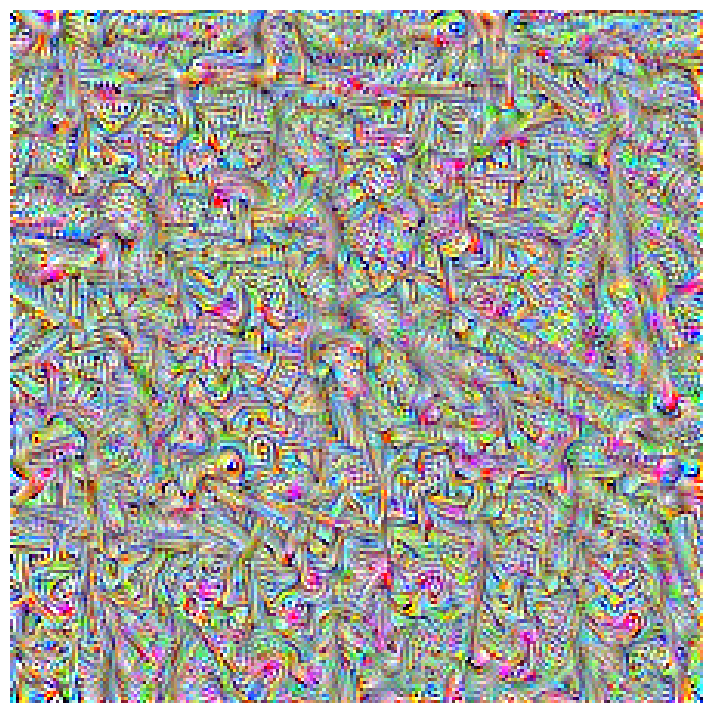

In [39]:
from matplotlib import pyplot as plt
from filters_visualization import visualise_layer_filter


layer_nmbr = 28
filter_nmbr = 5

layer_img = visualise_layer_filter(model,
                               layer_nmbr=layer_nmbr,
                               filter_nmbr=filter_nmbr,
                              num_optim_steps=30)

plt.figure(figsize=(9,9))
plt.imshow(layer_img)
plt.axis("off")
plt.show()

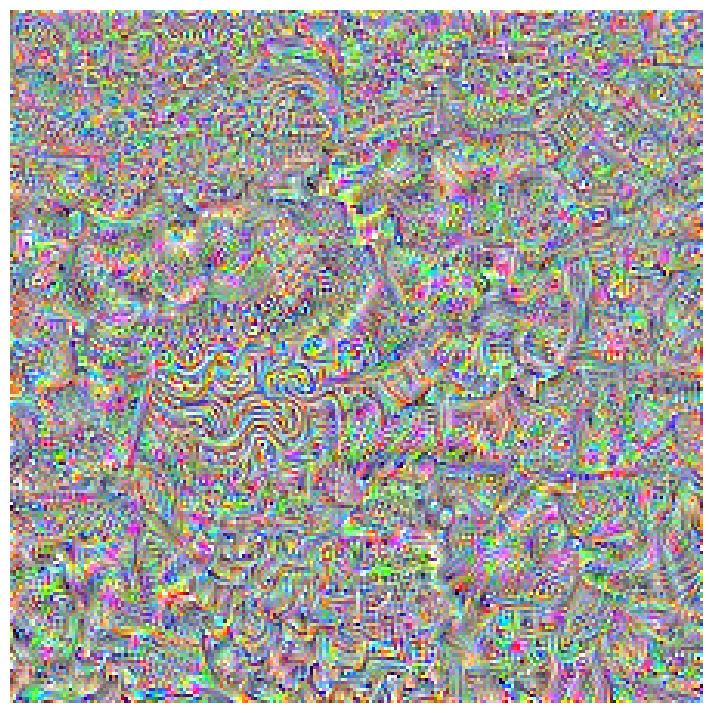

In [40]:
layer_nmbr = 28
filter_nmbr = 12

layer_img = visualise_layer_filter(model,
                               layer_nmbr=layer_nmbr,
                               filter_nmbr=filter_nmbr,
                              num_optim_steps=30)

plt.figure(figsize=(9,9))
plt.imshow(layer_img)
plt.axis("off")
plt.show()

## Task 1.4 - Visualize filters at different layers. 
Now repeat the process for for different
filters and different layers. 

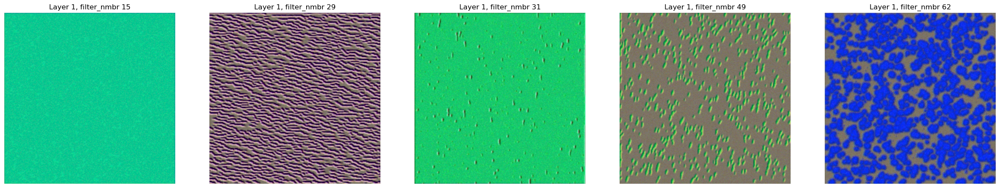

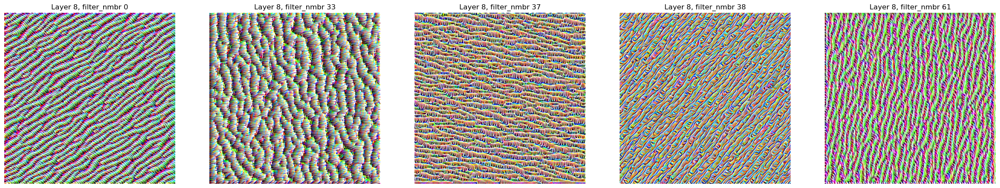

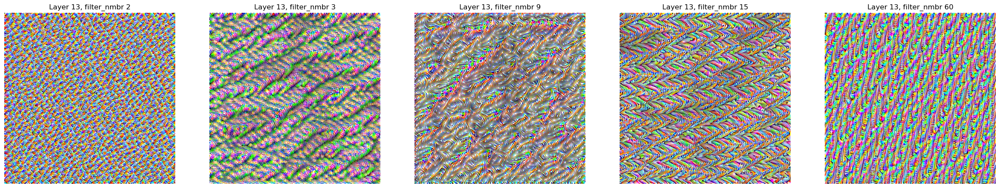

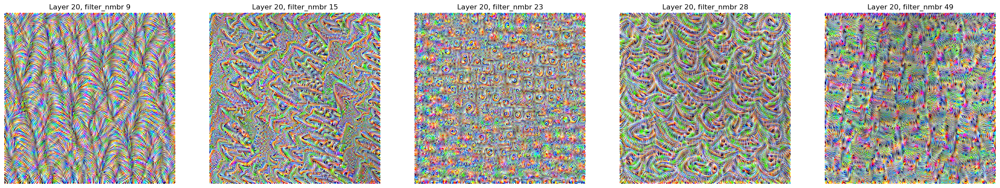

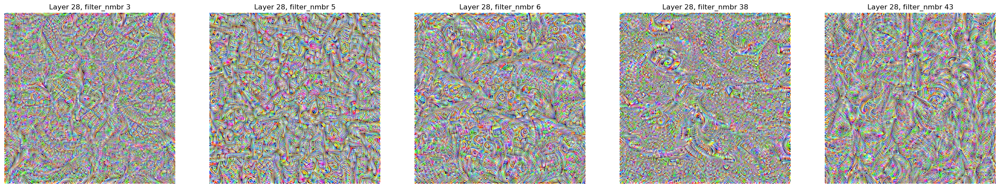

In [41]:
layer_nmbr = 28
filter_nmbr = 6

for layer_nmbr in [1, 8, 13, 20, 28]:
    layer_imgs = []
    fig, ax = plt.subplots(nrows=1, ncols=5, figsize=(30,6))
    for idx, filter_nmbr in enumerate(sorted(np.random.choice(64, 5,replace=False))):

        layer_img = visualise_layer_filter(model,
                               layer_nmbr=layer_nmbr,
                               filter_nmbr=filter_nmbr,
                              num_optim_steps=30)
        layer_imgs.append(layer_imgs)
    
    
        ax[idx].set_title(f"Layer {layer_nmbr}, filter_nmbr {filter_nmbr}")
        ax[idx].imshow(layer_img)
        ax[idx].axis('off')
    plt.show()

What do you observe going from earlier layers to later layers?
* Earlier layers capture low-level features (colors, edges pointing in certain directions)
* Later layers capture textures, and even later layers capture abstract patterns
* **In summary:** We have a hierarchical feature-representation with increasing abstraction

# Task 1.5 - Hyperparameter tuning. 

The process of visualization is quite sensitive to the
parameters. Some of the crucial parameters to tune are
* the number of optimization steps num_optim_steps
* the learning rate lr
* the optimizer

Vary those and describe what you see.


In [42]:
# -- modify visualise_layer_filter to accept different lr, num_optim_steps --
def visualise_layer_filter(model, 
                           layer_nmbr, 
                           filter_nmbr, 
                           num_optim_steps=126,
                           lr=0.1,
                           optimizer_type=Adam,
                           rand_img=np.uint8(np.random.uniform(low=120,
                                                               high=190,
                                                               size=(224, 224, 3)))):

    
    # Process image and return variable
    processed_image = preprocess_image(rand_img, False)
    processed_image = torch.tensor(processed_image, device=device).float()
    processed_image.requires_grad = True
    # Define optimizer for the image
    optimizer = optimizer_type([processed_image], lr=lr, weight_decay=1e-5)
    for i in range(1, num_optim_steps):
        optimizer.zero_grad()
        # Assign create image to a variable to move forward in the model
        x = processed_image
        for index, layer in enumerate(model):
            # Forward pass layer by layer
            x = layer(x)
            if index == layer_nmbr:
                # Only need to forward until the selected layer is reached
                # Now, x is the output of the selected layer
                break

        conv_output = x[0, filter_nmbr]
        # Loss function is the mean of the output of the selected layer/filter
        # We try to minimize the mean of the output of that specific filter
        loss = -torch.mean(conv_output)
        #print(f'Step {i:05d}. Loss:{loss.data.cpu().numpy():0.2f}')
        # Compute gradients
        loss.backward()
        # Apply gradients
        optimizer.step()
        # Recreate image
        optimized_image = recreate_image(processed_image.cpu())
        # Show image
    return optimized_image

### 1.5.1 Modify Optimization Steps


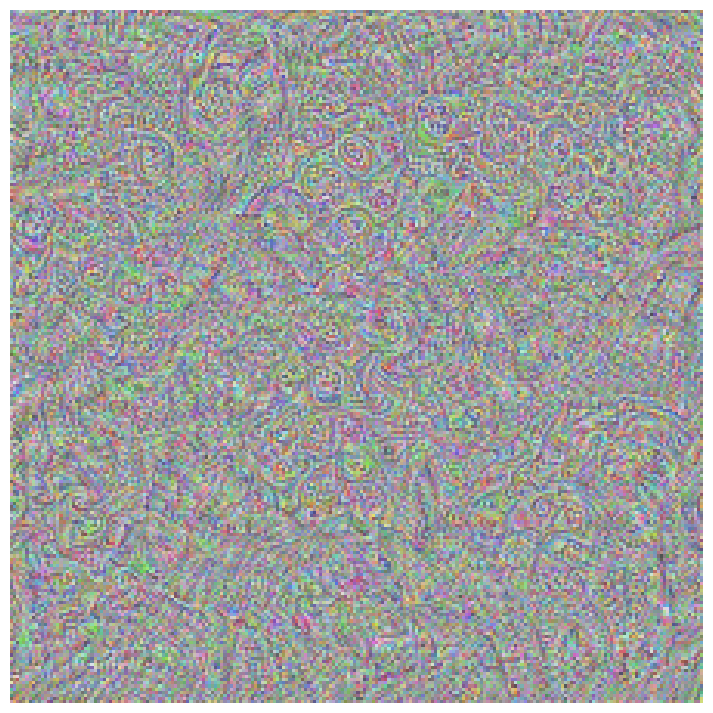

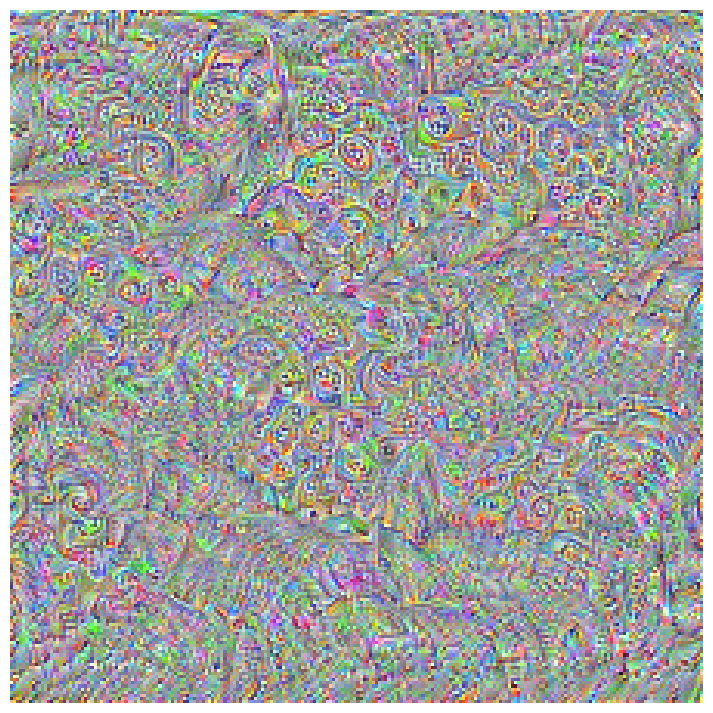

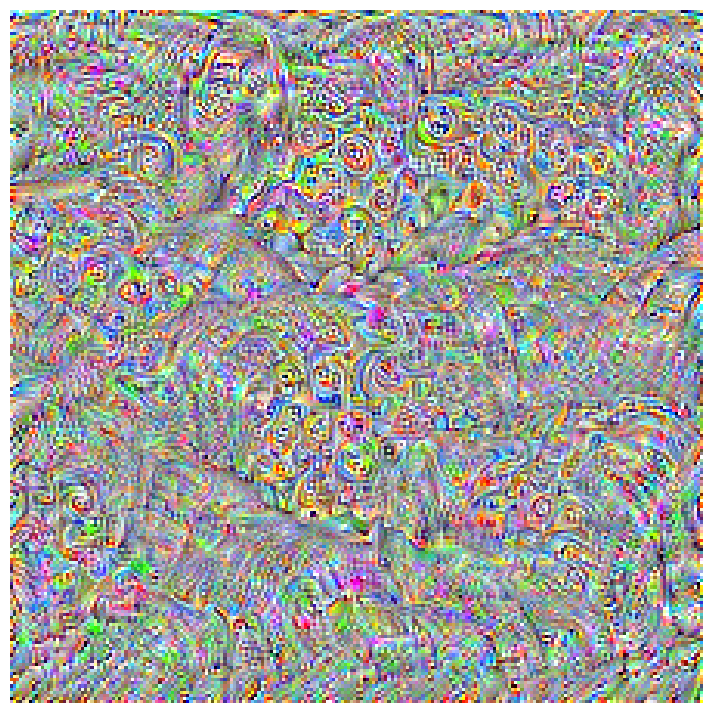

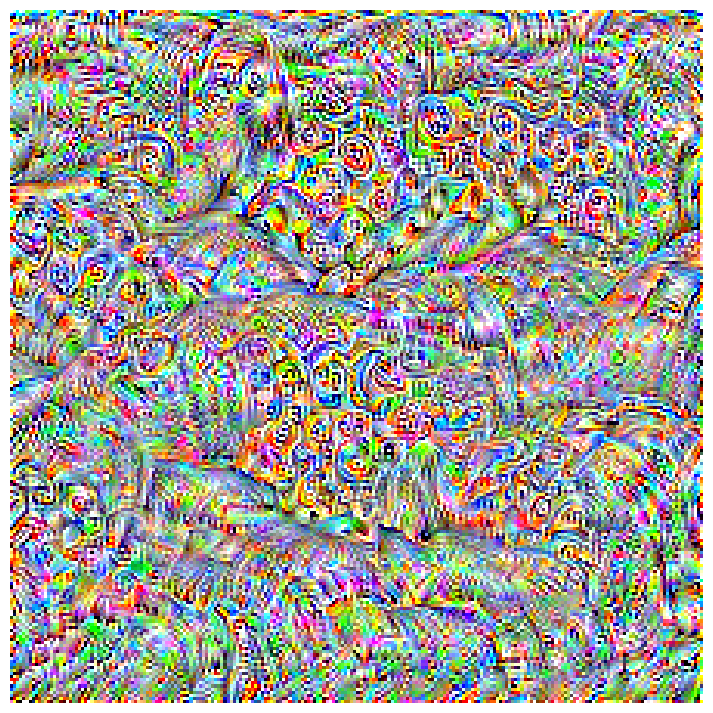

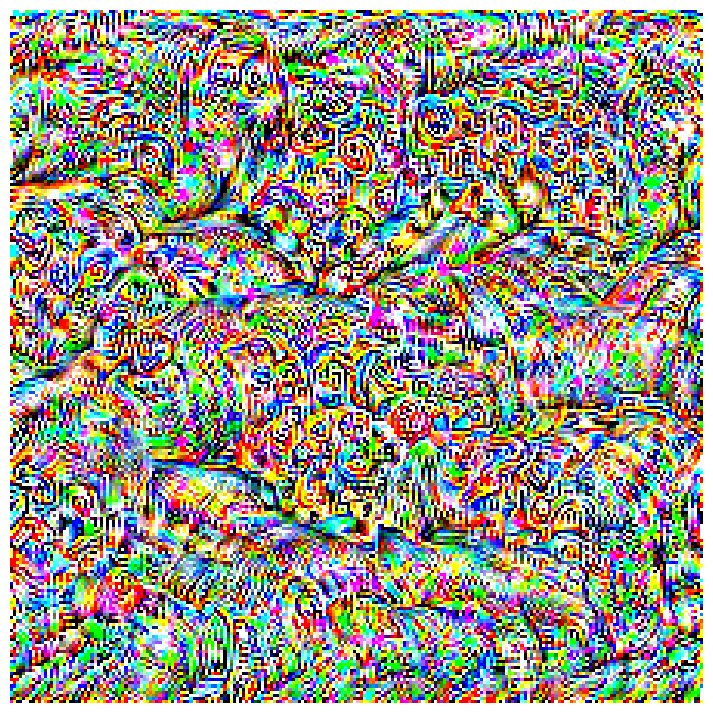

In [43]:
layer_nmbr = 28
filter_nmbr = 6
rand_img=np.uint8(np.random.uniform(low=120,high=190,size=(224, 224, 3)))
for num_steps in [10, 20, 30, 50, 100]:
    layer_img = visualise_layer_filter(model,
                                   layer_nmbr=layer_nmbr,
                                   filter_nmbr=filter_nmbr,
                                  num_optim_steps=num_steps,
                                       rand_img=rand_img)

    plt.figure(figsize=(9,9))
    plt.imshow(layer_img)
    plt.axis("off")
    plt.show()

What we observe: a higher learning rate essentially results in a higher contrast-image

### Task 1.5.2 Setting a different learning rate


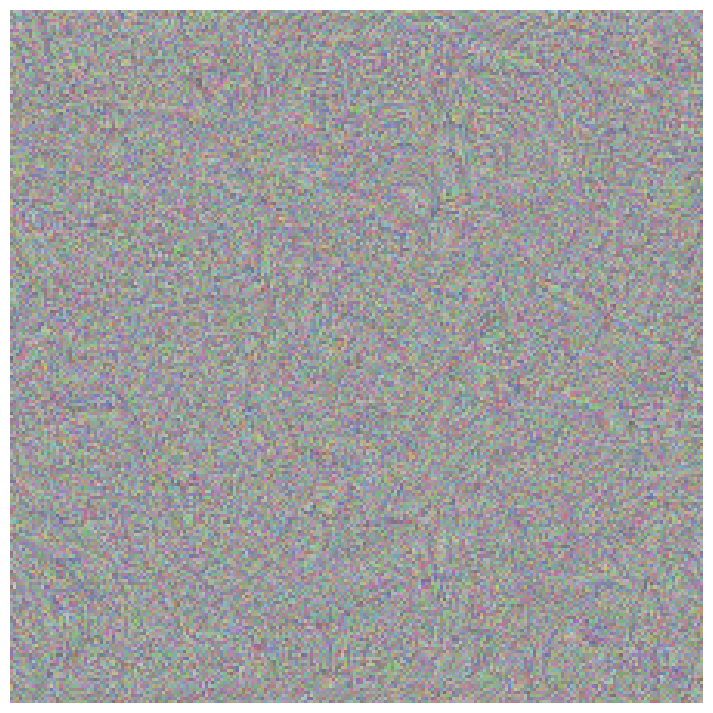

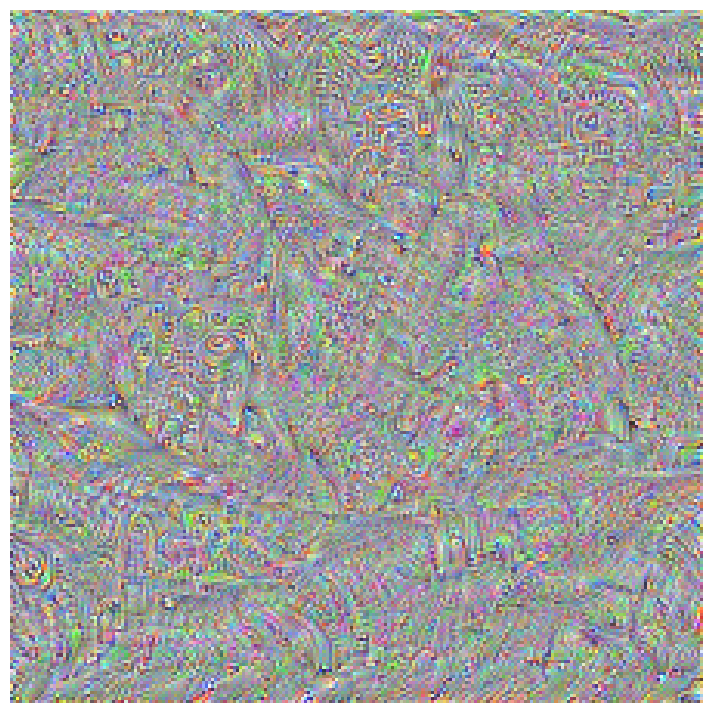

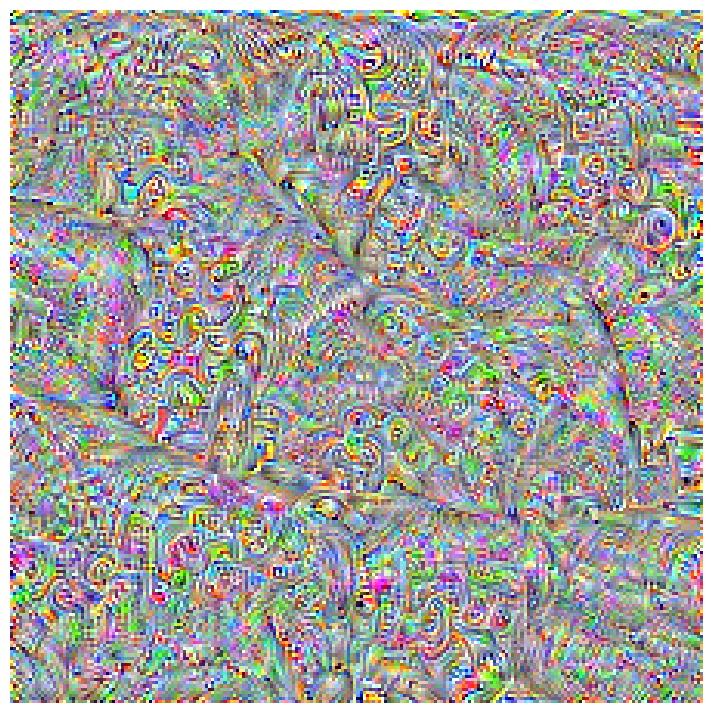

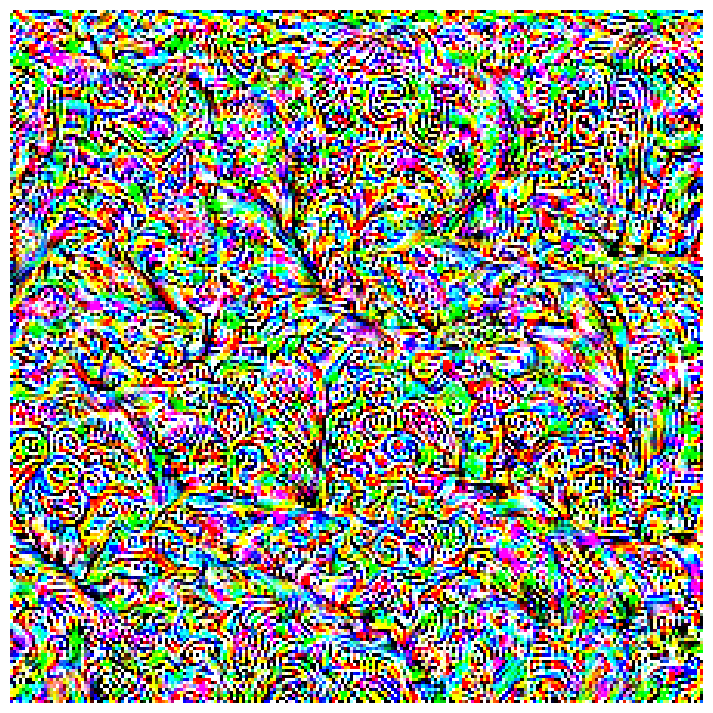

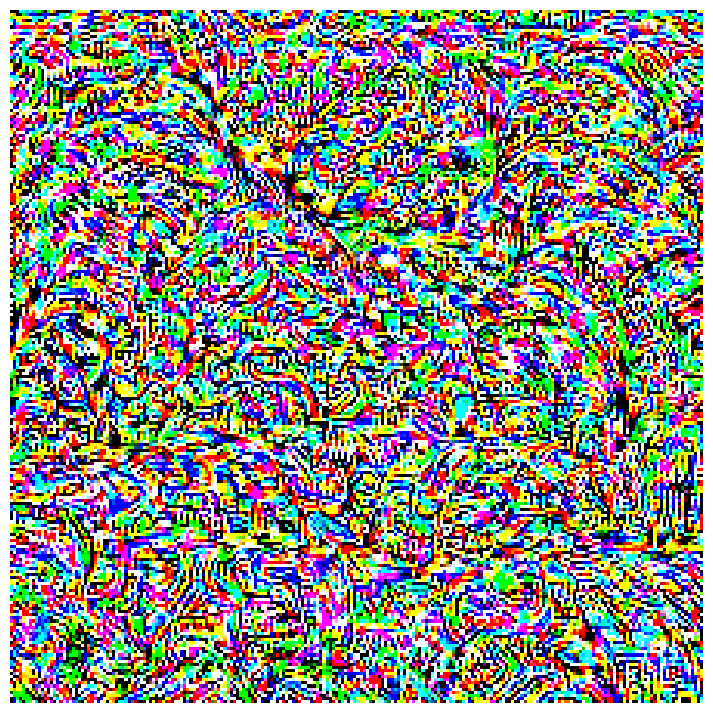

In [44]:
layer_nmbr = 28
filter_nmbr = 6
rand_img=np.uint8(np.random.uniform(low=120,high=190,size=(224, 224, 3)))
for lr in [0.01,0.05, 0.1, 0.5, 1.]:#for lr in [0.01, 0.1, 1.]:
    layer_img = visualise_layer_filter(model,
                                   layer_nmbr=layer_nmbr,
                                   filter_nmbr=filter_nmbr,
                                  num_optim_steps=30,
                                      lr=lr,
                                       rand_img=rand_img)

    plt.figure(figsize=(9,9))
    plt.imshow(layer_img)
    plt.axis("off")
    plt.show()

We essentially observe the same results as in the previous experiment: higher contrast for a higher learning rate. Furthermore, we actually observe that the structure of the image changes!

### Task 1.5.3 Setting a different optimizer type
We first experiment with multiple optimizers (ADAM, SGD, Adadelta)

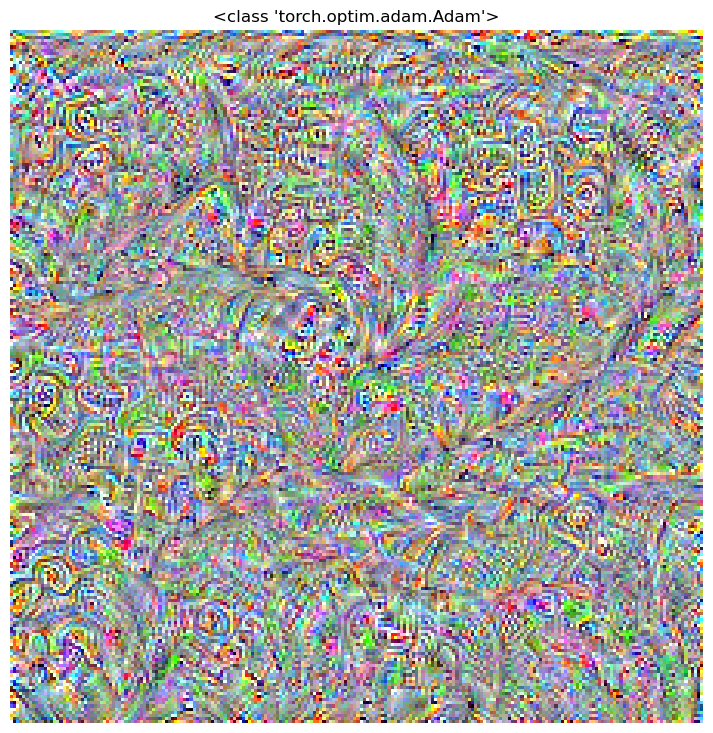

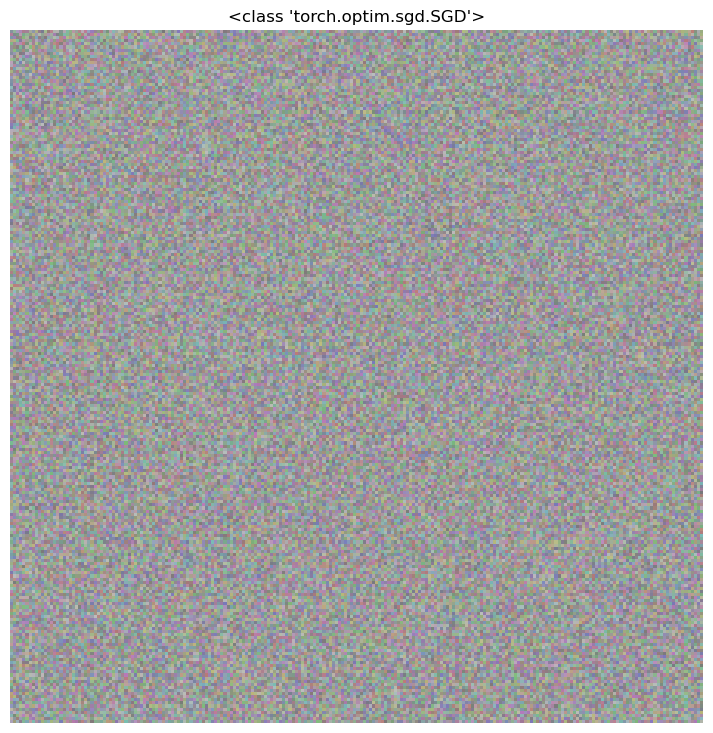

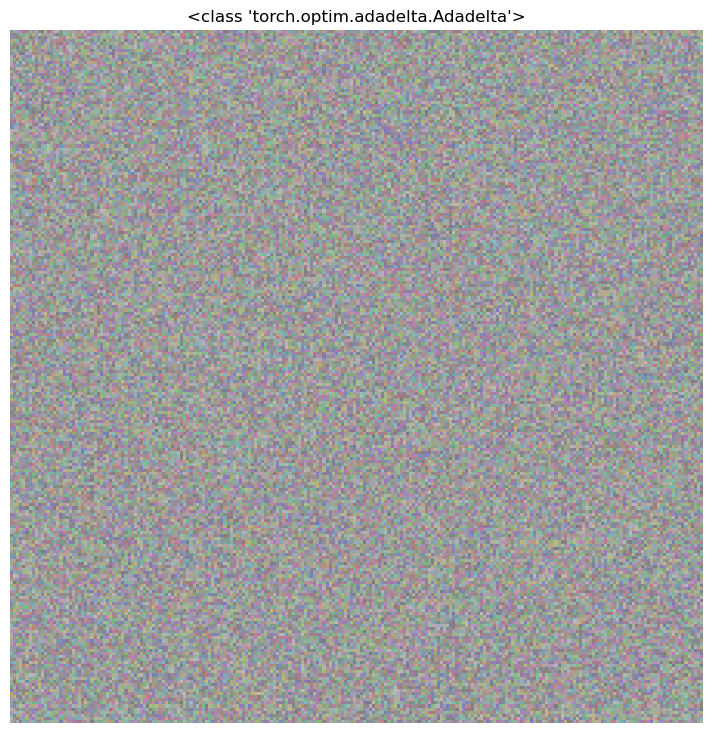

In [45]:
from torch.optim import Adam, SGD, Adadelta

layer_nmbr = 28
filter_nmbr = 6
for optimizer_type, lr in zip([Adam, SGD, Adadelta],
                              [0.1, 0.1, 0.1]):
    layer_img = visualise_layer_filter(model,
                                   layer_nmbr=layer_nmbr,
                                   filter_nmbr=filter_nmbr,
                                  num_optim_steps=30,
                                       optimizer_type=optimizer_type,
                                      lr=lr)

    plt.figure(figsize=(9,9))
    plt.title(f"{optimizer_type}")
    plt.imshow(layer_img)
    plt.axis("off")
    plt.show()

Observation: For the same learning rate, we get very different results (Adam converged to a structured image, while Adadelta and SGD represent noise)

Now we test different learning rates.

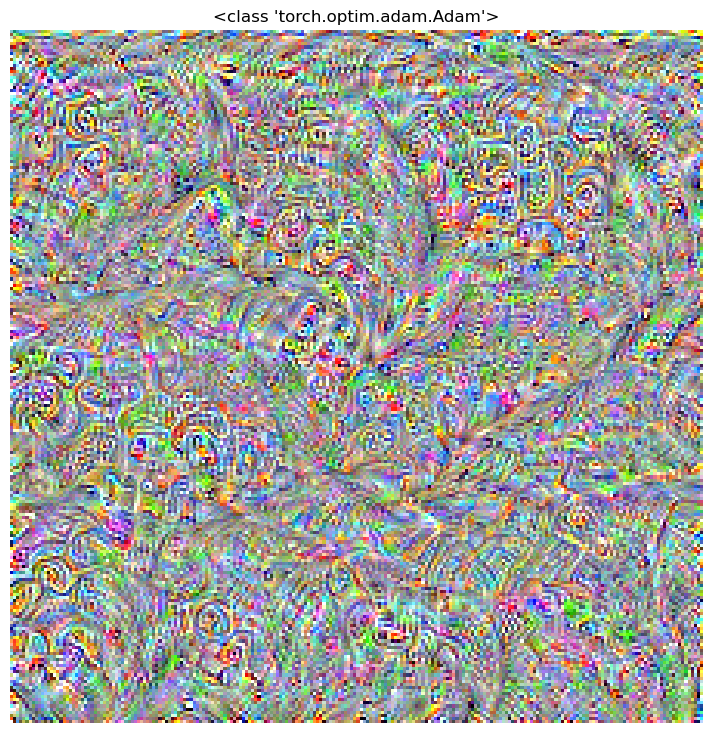

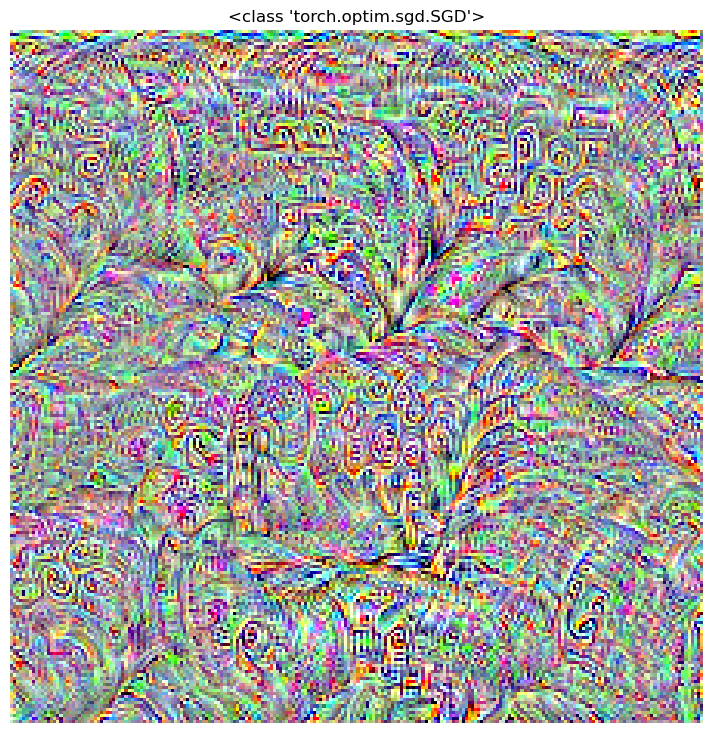

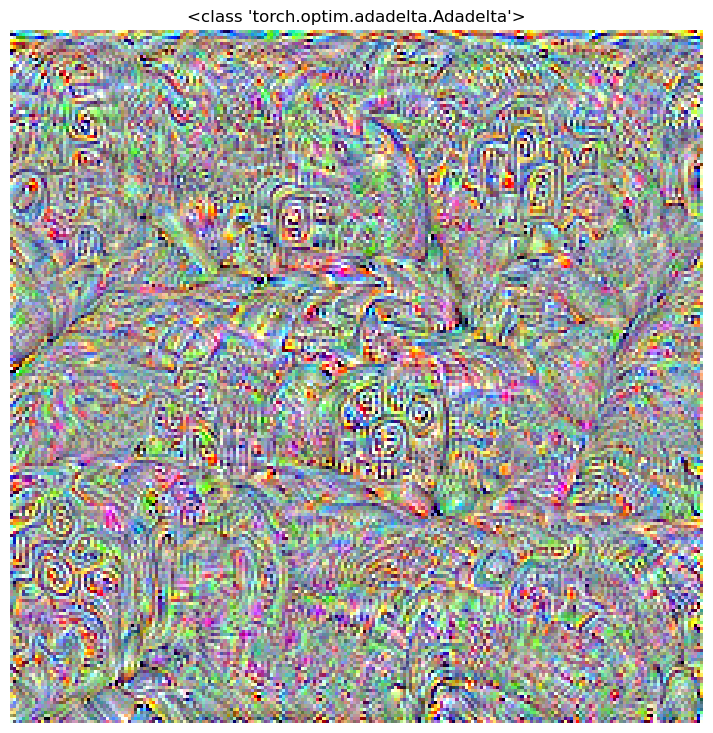

In [46]:
layer_nmbr = 28
filter_nmbr = 6
for optimizer_type, lr in zip([Adam, SGD, Adadelta],
                              [0.1, 30, 50]):
    layer_img = visualise_layer_filter(model,
                                   layer_nmbr=layer_nmbr,
                                   filter_nmbr=filter_nmbr,
                                  num_optim_steps=30,
                                       optimizer_type=optimizer_type,
                                      lr=lr)

    plt.figure(figsize=(9,9))
    plt.title(f"{optimizer_type}")
    plt.imshow(layer_img)
    plt.axis("off")
    plt.show()

### Task 1.5.3 Different initial images


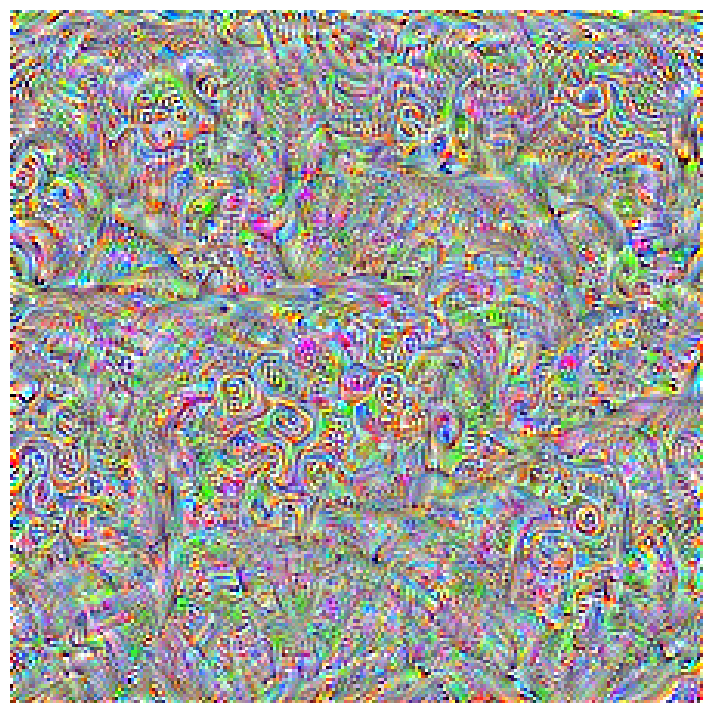

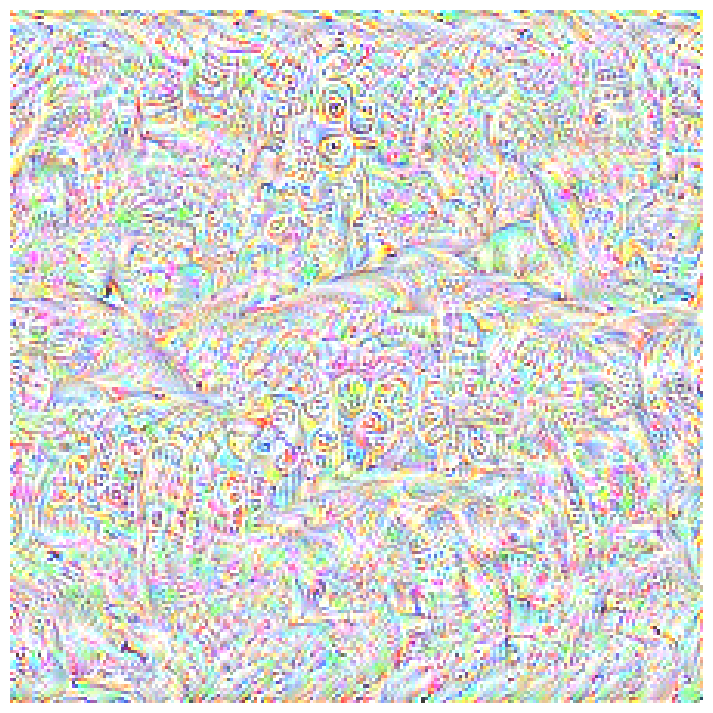

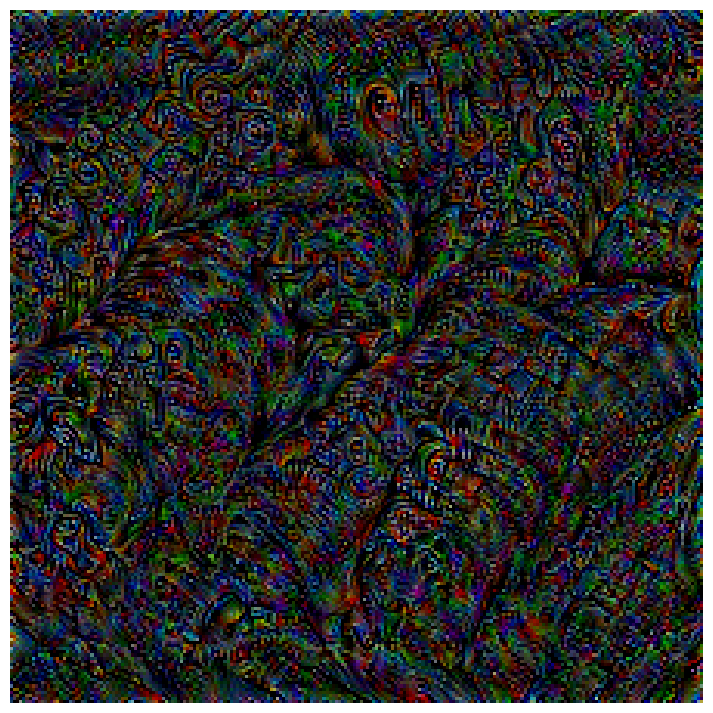

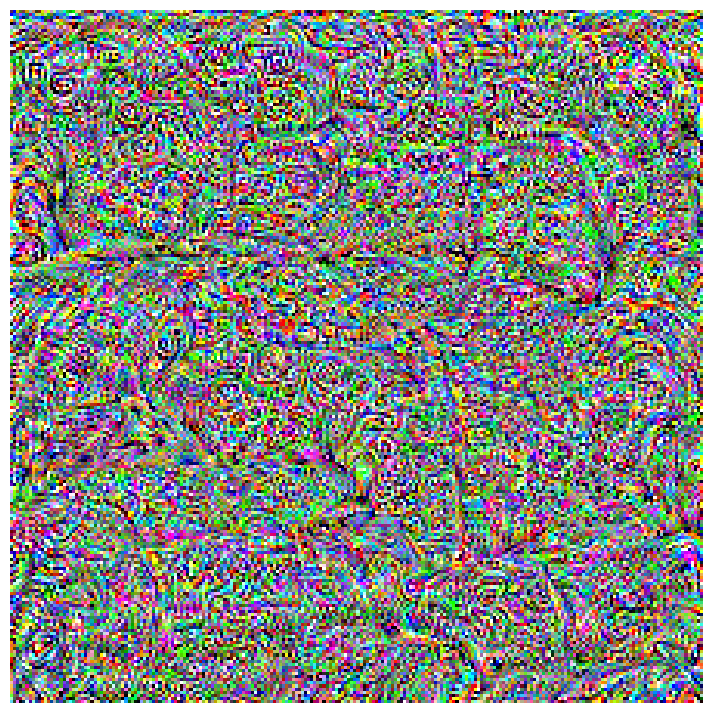

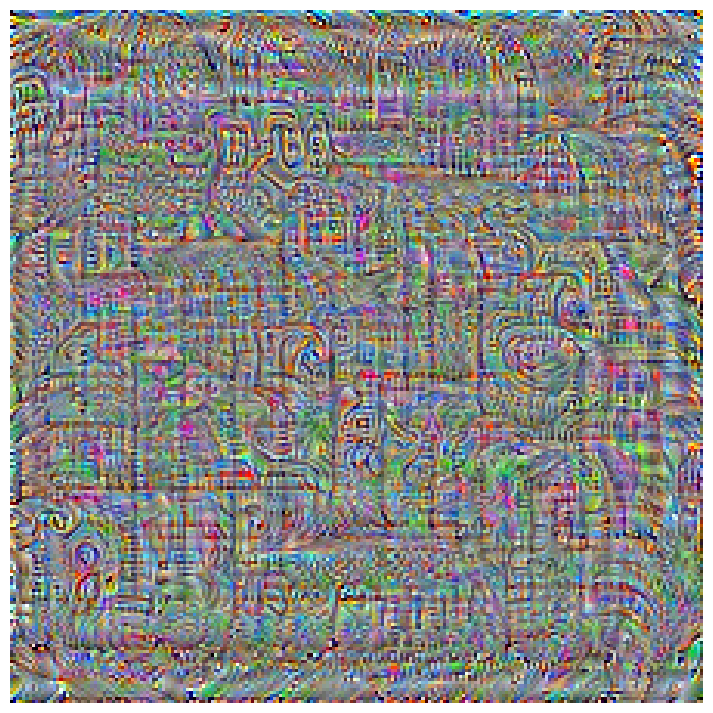

In [47]:
layer_nmbr = 28
filter_nmbr = 6

for rand_img in [
    np.uint8(np.random.uniform(low=120, high=190, size=(224, 224, 3))),
    np.uint8(np.random.uniform(low=200, high=240, size=(224, 224, 3))),
    np.uint8(np.random.uniform(low=10,  high=40,  size=(224, 224, 3))),
    np.uint8(np.random.uniform(low=10,  high=240, size=(224, 224, 3))),
    np.uint8(np.random.uniform(low=128,  high=128, size=(224, 224, 3)))                 
    ]:
    
    layer_img = visualise_layer_filter(model,
                                   layer_nmbr=layer_nmbr,
                                   filter_nmbr=filter_nmbr,
                                       num_optim_steps=30,
                                       rand_img=rand_img)

    plt.figure(figsize=(9,9))
    plt.imshow(layer_img)
    plt.axis("off")
    plt.show()

Observation: As we can see, the output highly depends on the range of the initial image. Moreover, a uniform image yields bad results.

# Task 1.6 - Pretrained weights.
Now we don't load the pretrained weights. 

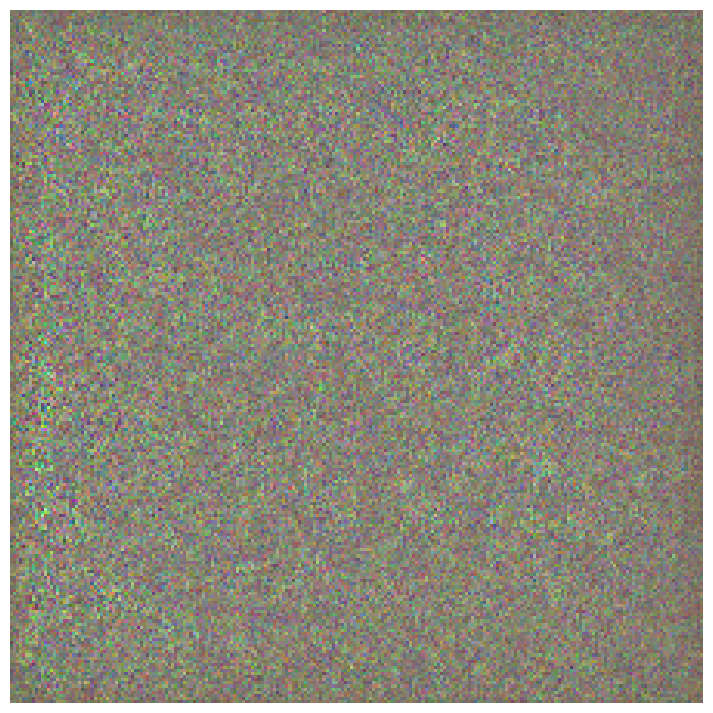

In [48]:
# Fully connected layer is not needed
model_no_pretrain = models.vgg16(pretrained=False).features
# Printing model descriptions.
model_no_pretrain.eval()
model_no_pretrain.to(device)
# Fix model weights
for param in model_no_pretrain.parameters():
    param.requires_grad = False
# Enable GPU

    

layer_nmbr = 28
filter_nmbr = 6

layer_img = visualise_layer_filter(model_no_pretrain,
                               layer_nmbr=layer_nmbr,
                               filter_nmbr=filter_nmbr,
                              num_optim_steps=30)

plt.figure(figsize=(9,9))
plt.imshow(layer_img)
plt.axis("off")
plt.show()

Observation: As expected, we get random noise as an output. This is due to the model having randomly initialized weights.

------------------------------------------------

# Task 2: Deep Dream
Now we can establish a connection between the actual image content and what our neural network sees in those images.
## Task 2.1 Most activated filters for every image.

* Download 5 random images
* fix particular layer. we choose layer_nmbr = 30
* select 10 most activated filters
    * Note: By "most activated filters" we actually mean the maximum activation value for each filter across its spatial dimensions (height and width).
    * More precisely, we compute $$m_{\ell, f}  :=\underset{i,j}{\operatorname{max}} \phi(I)^{(\ell, f)}_{i,j} \quad \text{for } f=1, \dots, F$$
* Then we choose 10 $f$ for the 10 highest $m_{\ell, f}$

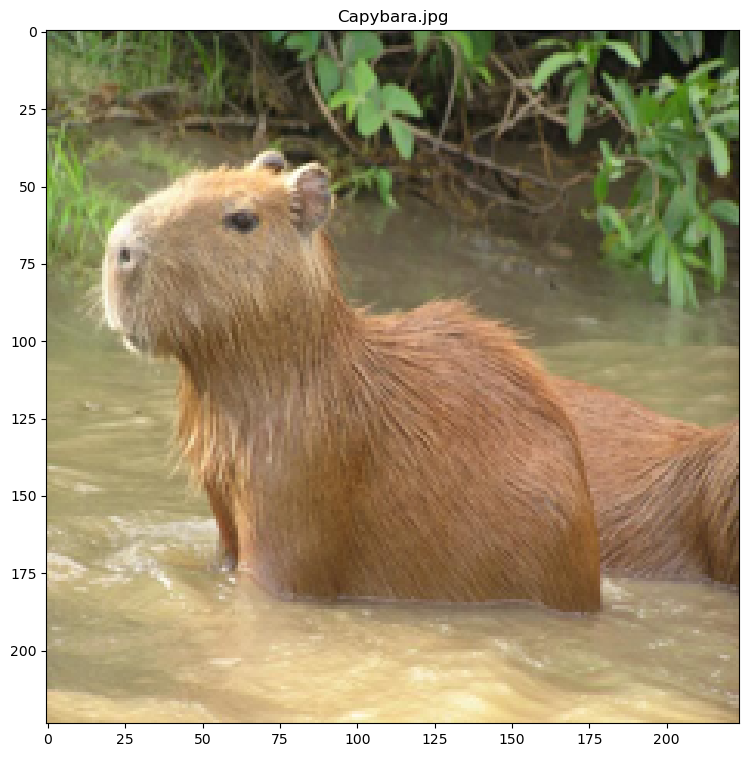

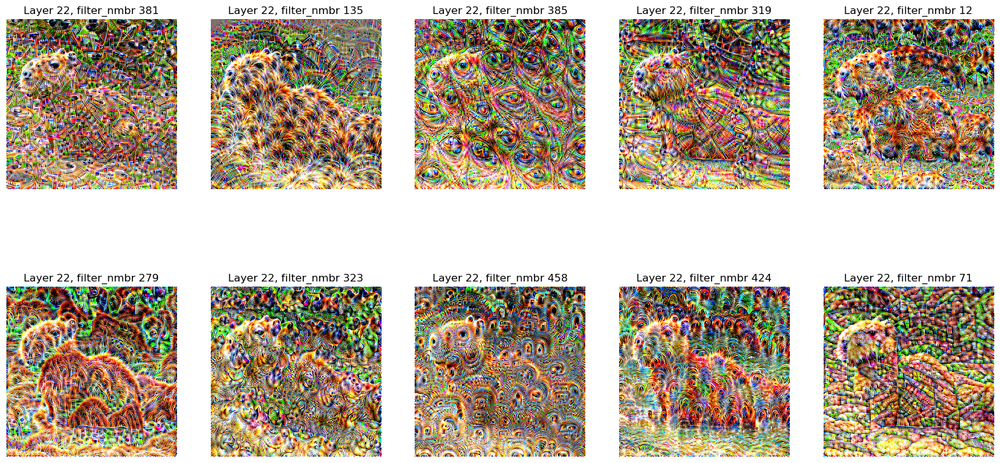

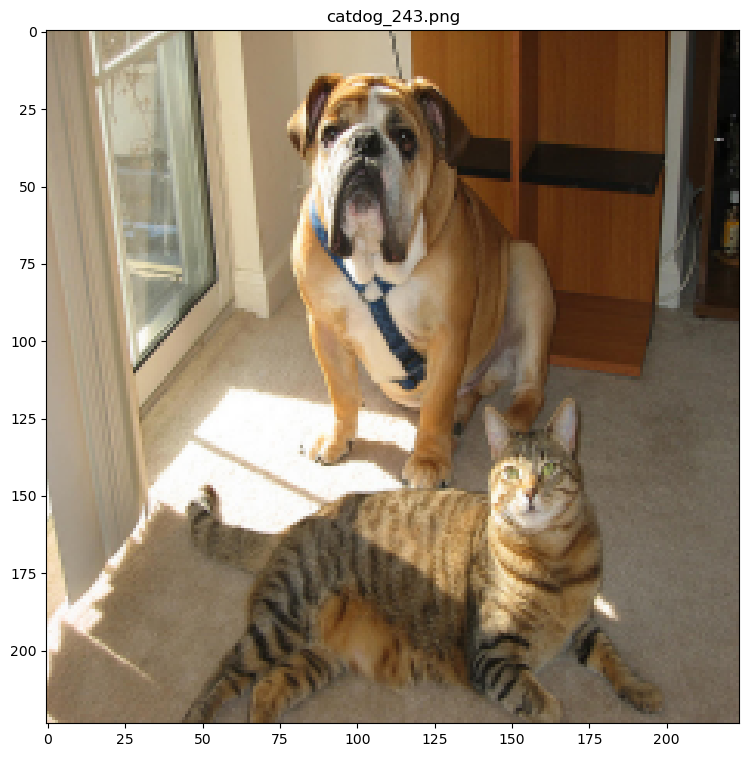

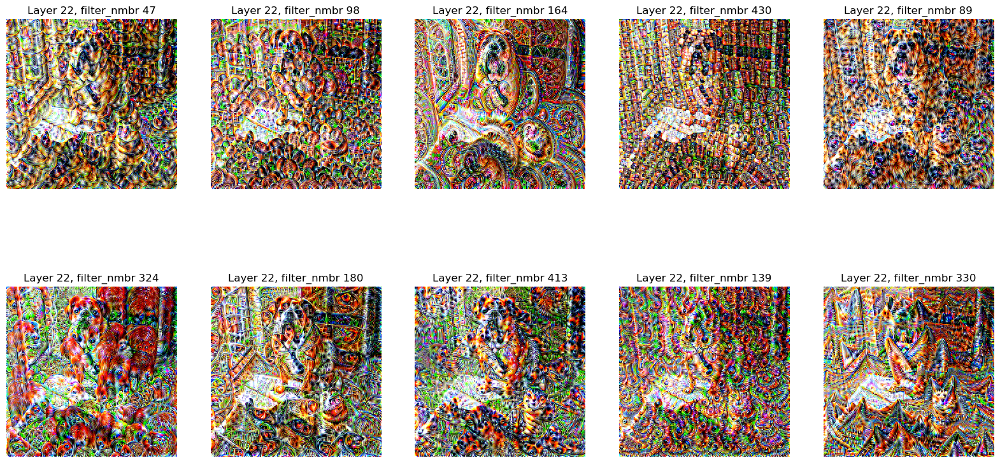

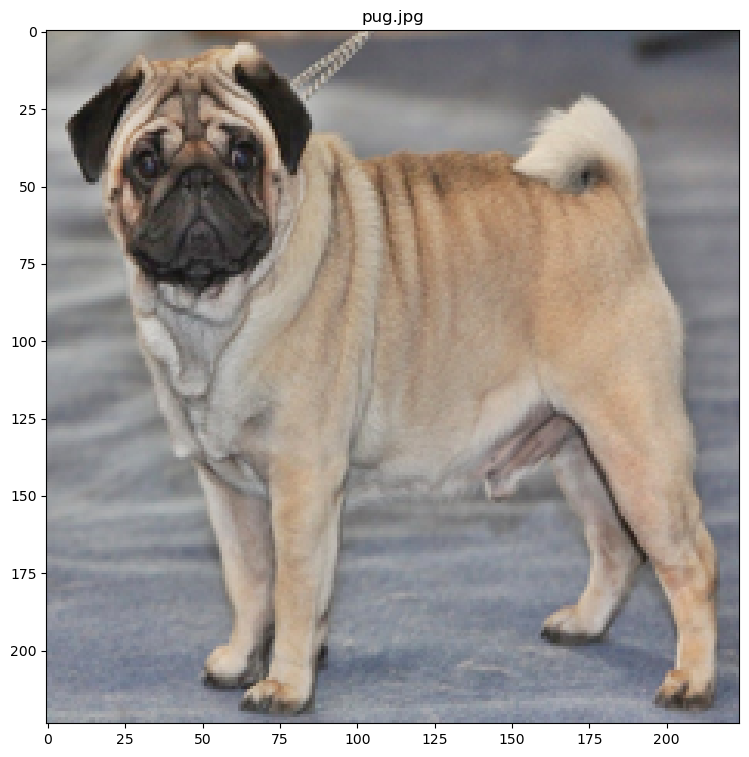

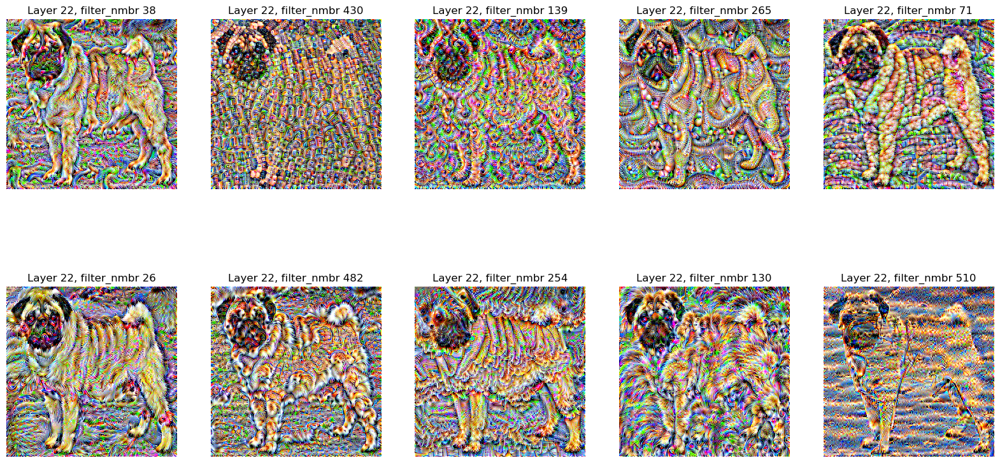

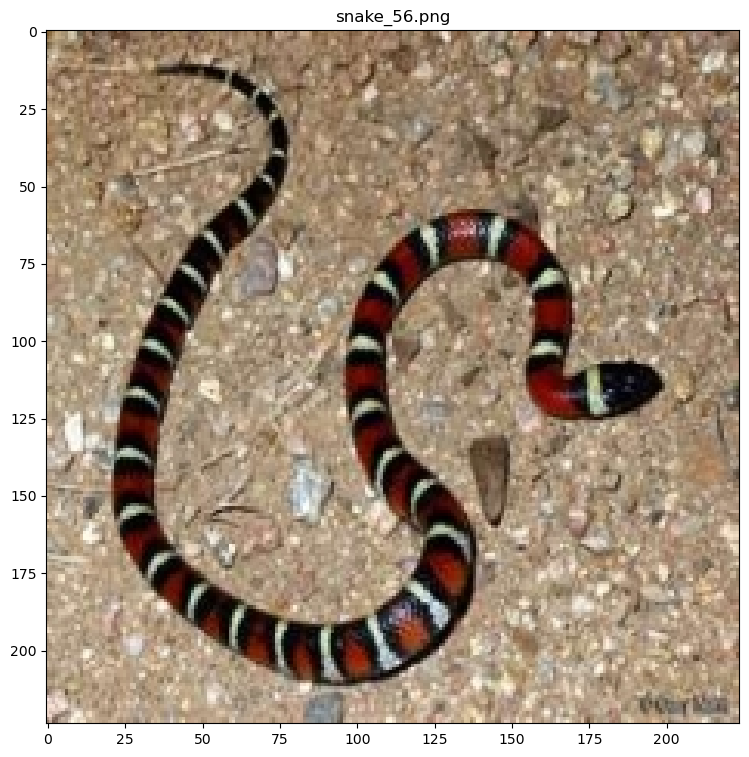

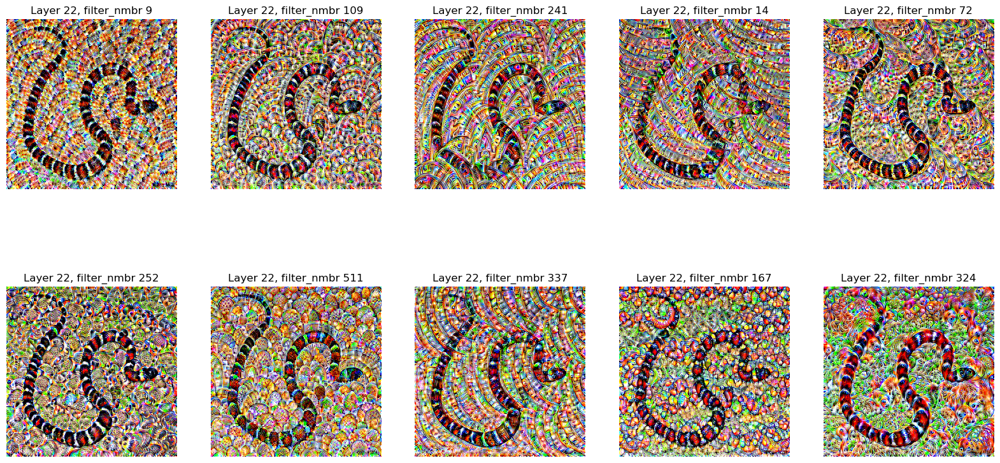

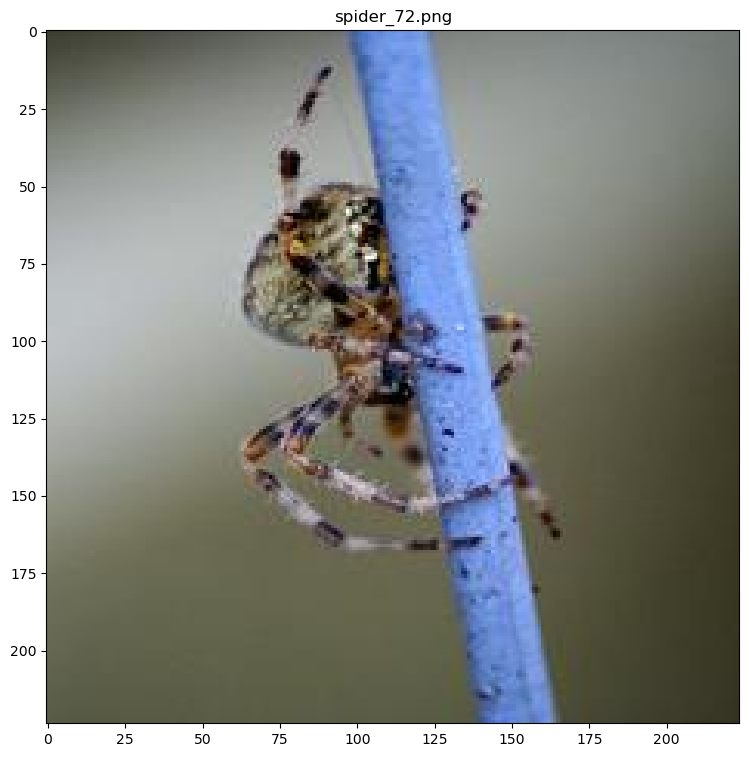

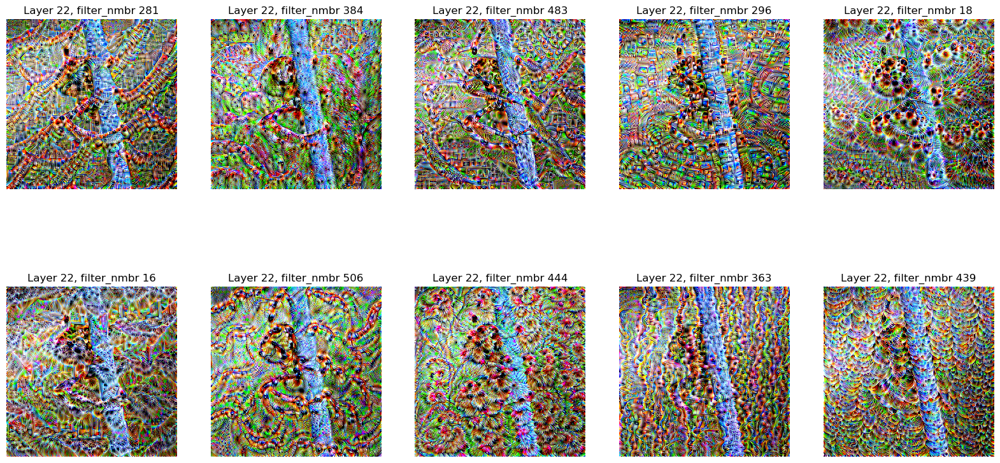

In [49]:
from PIL import Image
from matplotlib import pyplot as plt

# we choose 5 random images
all_images = [
    "Capybara.jpg",
    "catdog_243.png",
    "pug.jpg",
    "snake_56.png",
    "spider_72.png"
]

for image_name in all_images:
    
    # first we load our images
    input_image = Image.open(image_name).convert('RGB').resize((224, 224))
    # plot the image
    plt.figure(figsize=(9,9))
    plt.title(image_name)
    plt.imshow(input_image)
    plt.show()

    # good examples
    #layer_nmbr = 19#29
    layer_nmbr = 22#29

    processed_image = preprocess_image(input_image, True)
    processed_image = torch.tensor(processed_image, device=device).float()
    processed_image.requires_grad = False
    # Assign create image to a variable to move forward in the model
    x = processed_image
    for index, layer in enumerate(model):
        # Forward pass layer by layer
        x = layer(x)
        if index == layer_nmbr:
            break
    
        conv_layer_output = x[0]
        # print(conv_layer_output.shape)
    conv_layer_output = conv_layer_output.cpu().detach().numpy()
    
    # Compute the most activated filters as follows:
    # 1.) compute np.max(conv_layer_output, axis=(1,2)):
    # * This computes the maximum activation value for each filter across its spatial dimensions (height and width).
    # * The result is an array of shape (num_filters), where each element represents the maximum activation of a particular filter for each input sample.
    # 2.) we select the 10 highest indices via np.argpartition.
    most_activated_filters_idcs = np.argpartition(-np.max(conv_layer_output, axis=(1,2)), kth=range(10))[:10]
    # print(most_activated_filters_idcs)
    #break

    fig, ax = plt.subplots(nrows=2, ncols=5, figsize=(20,10))
    for idx, filter_nmbr in enumerate(most_activated_filters_idcs):
        # print(filter_nmbr)
    
        layer_img = visualise_layer_filter(model,
                               layer_nmbr=layer_nmbr,
                               filter_nmbr=filter_nmbr,
                              num_optim_steps=50,
                                           rand_img=input_image
                                           )
    
    
        ax[idx // 5, idx % 5].set_title(f"Layer {layer_nmbr}, filter_nmbr {filter_nmbr}")
        ax[idx // 5, idx % 5].imshow(layer_img)
        ax[idx // 5, idx % 5].axis('off')
    plt.show()


Observation: The initial image is represented in the final output, but the output gets too noisy as a result.
Therefore, we need to adjust our optimization process

## Task 1.2 - Total variation loss
In order to make the learned image more "natural", we are adding a regularization-term, namely total variation loss:
$$TV(I) = \sum_{i,j} \sqrt{|I_{i+1, j} - I_{i,j}|^2 + |I_{i,j+1} - I_{i,j}|^2}$$

We include this for our image-optimization-objective

$$I^* = \underset{I \in \mathbb{R}^{h \times w \times 3}}{\operatorname{argmax}} \Big[\frac{1}{w\cdot h}\sum_{i,j} \phi(I)^{(\ell, f)}_{i,j} - \lambda\cdot TV(I)\Big]$$
$$= \underset{I \in \mathbb{R}^{h \times w \times 3}}{\operatorname{argmin}} \Big[-\frac{1}{w\cdot h}\sum_{i,j} \phi(I)^{(\ell, f)}_{i,j}\Big + \lambda\cdot TV(I)\Big]$$

In [50]:
# Total Variation Loss
def total_variation_loss(img, weight):
    bs_img, c_img, h_img, w_img = img.size()
    tv_h = torch.pow(img[:,:,1:,:]-img[:,:,:-1,:], 2).sum()
    tv_w = torch.pow(img[:,:,:,1:]-img[:,:,:,:-1], 2).sum()
    return weight*(tv_h+tv_w)/(bs_img*c_img*h_img*w_img)

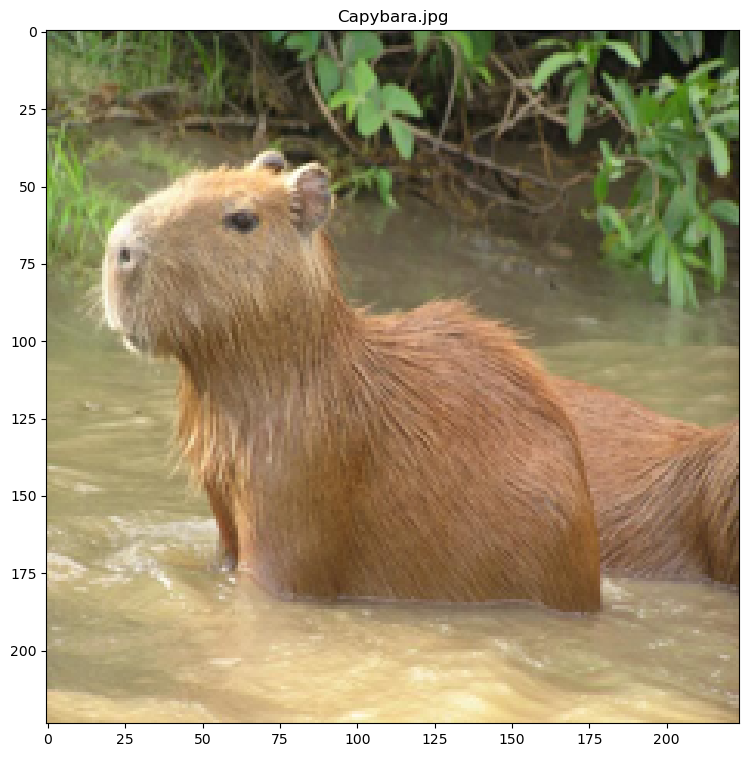

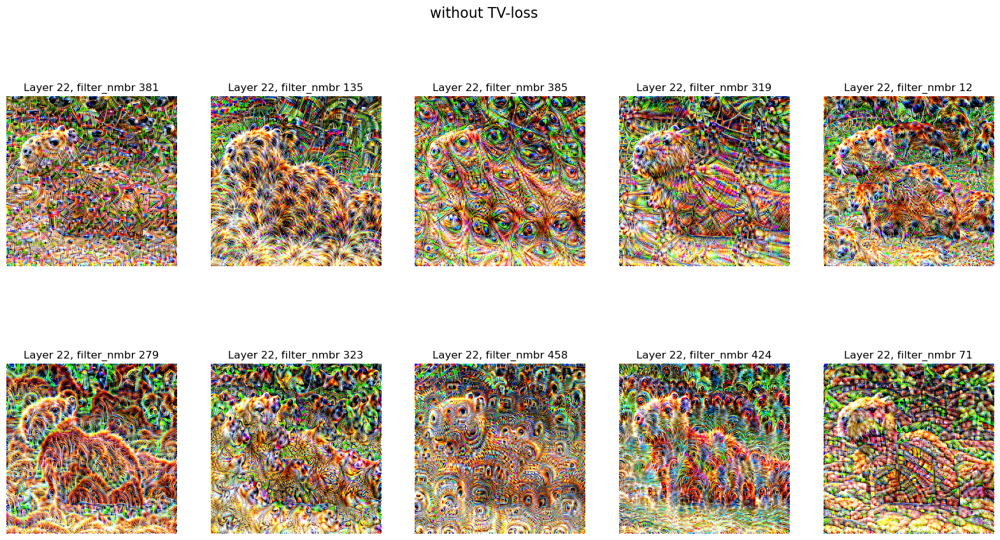

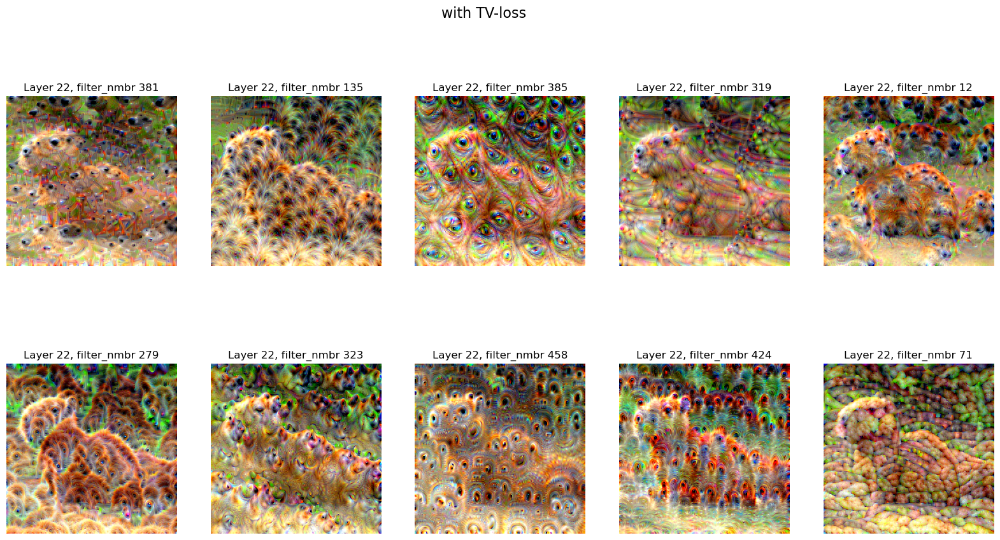

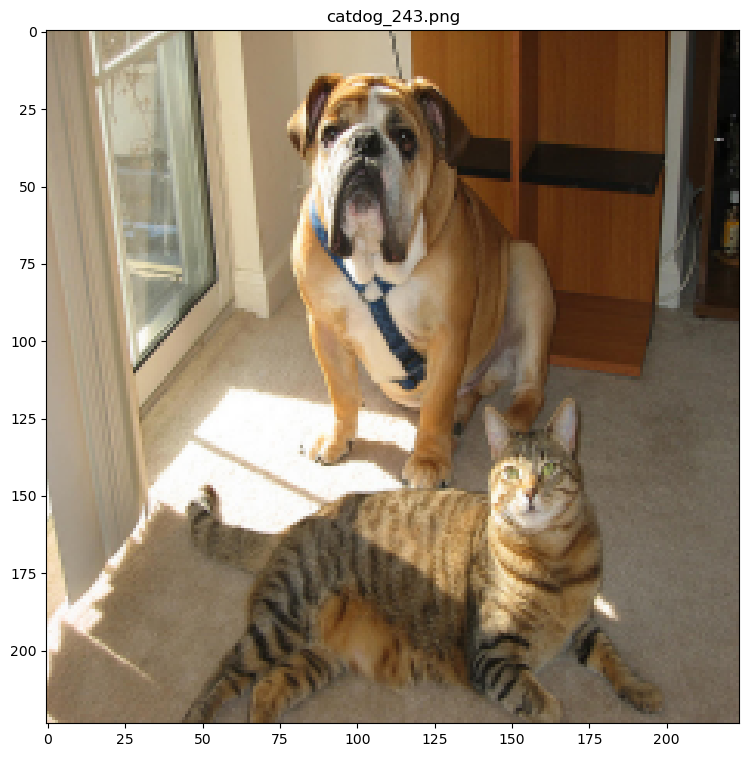

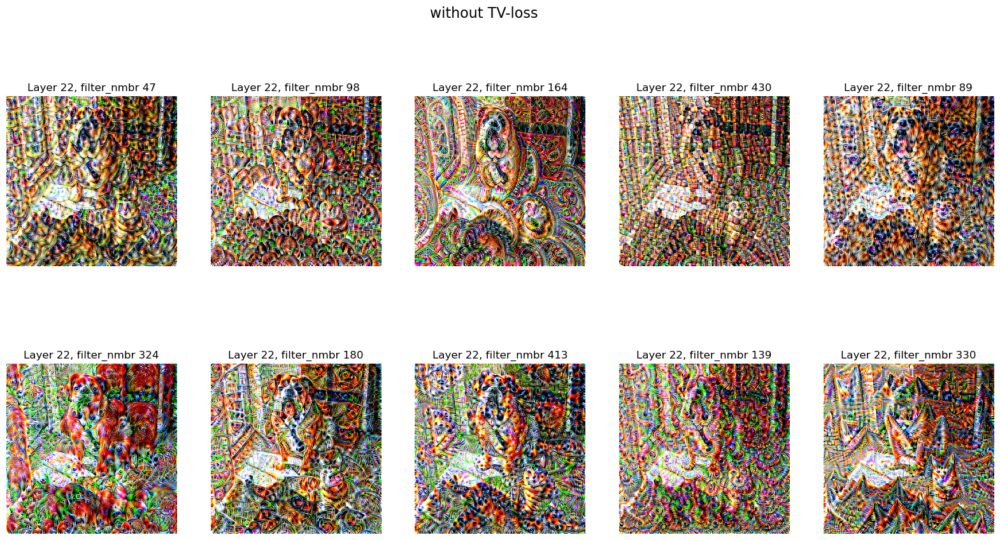

In [ ]:
# now we modify the visualization method to include the TV-loss:
def visualise_layer_filter(model, layer_nmbr, filter_nmbr, rand_img, num_optim_steps=50, tv_loss_w=0.):
    # Generate a random image
    #rand_img = np.uint8(np.random.normal(loc=140, scale=20, size=(224, 224, 3)))

    # Process image and return variable
    processed_image = preprocess_image(rand_img, True)
    processed_image = torch.tensor(processed_image, device=device).float()
    processed_image.requires_grad = True
    # Define optimizer for the image
    optimizer = Adam([processed_image], lr=0.1)
    for i in range(1, num_optim_steps):
        optimizer.zero_grad()
        # Assign create image to a variable to move forward in the model
        x = processed_image
        for index, layer in enumerate(model):
            # Forward pass layer by layer
            x = layer(x)
            if index == layer_nmbr:
                # Only need to forward until the selected layer is reached
                # Now, x is the output of the selected layer
                break

        conv_output = x[0, filter_nmbr]
        # Loss function is the mean of the output of the selected layer/filter
        # We try to minimize the mean of the output of that specific filter
        loss_tv = total_variation_loss(processed_image, weight=tv_loss_w)
        loss = -torch.mean(conv_output) + loss_tv
        #print(f'Step {i:05d}. Loss:{loss.data.cpu().numpy():0.2f}')
        # Compute gradients
        loss.backward()
        # Apply gradients
        optimizer.step()
        # Recreate image
        optimized_image = recreate_image(processed_image.cpu())
        # Show image
    return optimized_image

for image_name in all_images:
    
    # first we load our images
    input_image = Image.open(image_name).convert('RGB').resize((224, 224))
    # plot the image
    plt.figure(figsize=(9,9))
    plt.title(image_name)
    plt.imshow(input_image)
    plt.show()

    layer_nmbr = 22#30

    processed_image = preprocess_image(input_image, True)
    processed_image = torch.tensor(processed_image, device=device).float()
    processed_image.requires_grad = False
    # Assign create image to a variable to move forward in the model
    x = processed_image
    for index, layer in enumerate(model):
        # Forward pass layer by layer
        x = layer(x)
        if index == layer_nmbr:
            break
    
        conv_layer_output = x[0]
        # print(conv_layer_output.shape)
    conv_layer_output = conv_layer_output.cpu().detach().numpy()
    
    # Compute the most activated filters as follows:
    # 1.) compute np.max(conv_layer_output, axis=(1,2)):
    # * This computes the maximum activation value for each filter across its spatial dimensions (height and width).
    # * The result is an array of shape (num_filters), where each element represents the maximum activation of a particular filter for each input sample.
    # 2.) we select the 10 highest indices via np.argpartition.
    most_activated_filters_idcs = np.argpartition(-np.max(conv_layer_output, axis=(1,2)), kth=range(10))[:10]
    # print(most_activated_filters_idcs)
    #break

    # first we visualize the filters without TV-loss
    fig, ax = plt.subplots(nrows=2, ncols=5, figsize=(20,10))
    for idx, filter_nmbr in enumerate(most_activated_filters_idcs):
        # print(filter_nmbr)
    
        layer_img = visualise_layer_filter(model,
                               layer_nmbr=layer_nmbr,
                               filter_nmbr=filter_nmbr,
                              num_optim_steps=50,
                                           tv_loss_w=0,
                                           rand_img=input_image
                                           )
    
    
        ax[idx // 5, idx % 5].set_title(f"Layer {layer_nmbr}, filter_nmbr {filter_nmbr}")
        ax[idx // 5, idx % 5].imshow(layer_img)
        ax[idx // 5, idx % 5].axis('off')
    fig.suptitle('without TV-loss', fontsize=16)
    plt.show()
    # now we include the TV-loss
    fig, ax = plt.subplots(nrows=2, ncols=5, figsize=(20,10))
    for idx, filter_nmbr in enumerate(most_activated_filters_idcs):
        # print(filter_nmbr)
    
        layer_img = visualise_layer_filter(model,
                               layer_nmbr=layer_nmbr,
                               filter_nmbr=filter_nmbr,
                              num_optim_steps=50,
                                           tv_loss_w=80,
                                           rand_img=input_image
                                           )
    
    
        ax[idx // 5, idx % 5].set_title(f"Layer {layer_nmbr}, filter_nmbr {filter_nmbr}")
        ax[idx // 5, idx % 5].imshow(layer_img)
        ax[idx // 5, idx % 5].axis('off')
    fig.suptitle('with TV-loss', fontsize=16)
    plt.show()

## Task 1.3 - Deep Dream
Two important modifications:
1) Change the input image to a real photograph
2) maximize activations of all the filters.For numerical stability you better use the $L_2$ norm of
the activations tensor and try to maximize this value during optimization.
--------------------------------------------------
For numerical stability, we once again adjust the optimization process:
$$I^* = \ \underset{I \in \mathbb{R}^{h \times w \times 3}}{\operatorname{argmax}} \Big[ \| \phi(I)^{(\ell)} \|_2 - \lambda\cdot TV(I)\Big]$$
$$= \ \underset{I \in \mathbb{R}^{h \times w \times 3}}{\operatorname{argmin}} \Big[ -\| \phi(I)^{(\ell)} \|_2 + \lambda\cdot TV(I)\Big]$$

In [ ]:
rand_img = np.uint8(input_image)
layer_nmbr=80
# Process image and return variable
processed_image = preprocess_image(rand_img, True)
processed_image = torch.tensor(processed_image, device=device).float()
processed_image.requires_grad = True
# Define optimizer for the image
optimizer = Adam([processed_image], lr=0.05)
for i in range(100):
    optimizer.zero_grad()
    # Assign create image to a variable to move forward in the model
    x = processed_image
    for index, layer in enumerate(model):
        # Forward pass layer by layer
        x = layer(x)
        if index == layer_nmbr:
            # Only need to forward until the selected layer is reached
            # Now, x is the output of the selected layer
            break

    conv_output = x[0]
    # Loss function is the mean of the output of the selected layer/filter
    # We try to minimize the mean of the output of that specific filter
    loss_tv = total_variation_loss(processed_image, weight=15.)
    loss = -torch.sqrt(torch.sum(torch.square(conv_output))) + loss_tv
    #print(f'Step {i:05d}. Loss:{loss.data.cpu().numpy():0.2f}')
    # Compute gradients
    loss.backward()
    # Apply gradients
    optimizer.step()
    # Recreate image
    optimized_image = recreate_image(processed_image.cpu())
    # Show image

    if i % 10 == 0:
        plt.figure(figsize=(9,9))
        plt.imshow(optimized_image)
        plt.show()

Now we do optimization over a certain number of layers for better quality:
$$I^* = \ \underset{I \in \mathbb{R}^{h \times w \times 3}}{\operatorname{argmin}} \Big[ -\sum_{\ell \in \mathcal{L}}\| \phi(I)^{(\ell)} \|_2 + \lambda\cdot TV(I)\Big]$$
for some chosen layers $\mathcal{L}$

In [ ]:
rand_img = np.uint8(input_image)
layer_nmbr=80
# Process image and return variable
processed_image = preprocess_image(rand_img, True)
processed_image = torch.tensor(processed_image, device=device).float()
processed_image.requires_grad = True
# Define optimizer for the image
optimizer = Adam([processed_image], lr=0.05)
for i in range(100):
    optimizer.zero_grad()
    # Assign create image to a variable to move forward in the model
    loss = 0
    x = processed_image
    for index, layer in enumerate(model):
        # Forward pass layer by layer
        x = layer(x)
        #if index == layer_nmbr:
            # Only need to forward until the selected layer is reached
            # Now, x is the output of the selected layer
            #break
        if index == np.random.choice([6, 11, 18, 23, 25, 30]):
            loss = loss - torch.sqrt(torch.sum(torch.square(x)))
    conv_output = x[0]
    # Loss function is the mean of the output of the selected layer/filter
    # We try to minimize the mean of the output of that specific filter
    loss_tv = total_variation_loss(processed_image, weight=2e4)
    loss = loss + loss_tv
    #print(f'Step {i:05d}. Loss:{loss.data.cpu().numpy():0.2f}')
    # Compute gradients
    loss.backward()
    # Apply gradients
    optimizer.step()
    # Recreate image
    optimized_image = recreate_image(processed_image.cpu())
    # Show image

    if i % 10 == 0:
        plt.figure(figsize=(9,9))
        plt.imshow(optimized_image)
        plt.show()

In [ ]:
# Let's do this for all images now :)
for image_name in all_images:

    # first we load our images
    input_image = Image.open(image_name).convert('RGB').resize((224, 224))
    # plot the image
    plt.figure(figsize=(9,9))
    plt.title(image_name)
    plt.imshow(input_image)
    plt.show()


    rand_img = np.uint8(input_image)
    # layer_nmbr=80
    # Process image and return variable
    processed_image = preprocess_image(rand_img, True)
    processed_image = torch.tensor(processed_image, device=device).float()
    processed_image.requires_grad = True
    # Define optimizer for the image
    optimizer = Adam([processed_image], lr=0.05)
    for i in range(100):
        optimizer.zero_grad()
        # Assign create image to a variable to move forward in the model
        loss = 0
        x = processed_image
        for index, layer in enumerate(model):
            # Forward pass layer by layer
            x = layer(x)
            #if index == layer_nmbr:
                # Only need to forward until the selected layer is reached
                # Now, x is the output of the selected layer
                #break
            if index == np.random.choice([6, 11, 18, 23, 25, 30]):
                loss = loss - torch.sqrt(torch.sum(torch.square(x)))
        conv_output = x[0]
        # Loss function is the mean of the output of the selected layer/filter
        # We try to minimize the mean of the output of that specific filter
        loss_tv = total_variation_loss(processed_image, weight=2e4)
        loss = loss + loss_tv
        #print(f'Step {i:05d}. Loss:{loss.data.cpu().numpy():0.2f}')
        # Compute gradients
        loss.backward()
        # Apply gradients
        optimizer.step()
        # Recreate image
        optimized_image = recreate_image(processed_image.cpu())
        # Show image

        if i % 10 == 0:
            plt.figure(figsize=(9,9))
            plt.imshow(optimized_image)
            plt.show()
